# tytaj tytul, opsi problemu , nasze dane

## importy

In [368]:
# import niezbędnych bibliotek
import cv2
import matplotlib.pyplot as plt
import numpy as np
import PIL
%matplotlib inline
from pandas import DataFrame
import pandas as pd
from IPython.display import display, HTML
from skimage.filters import (threshold_otsu, threshold_niblack,
                             threshold_sauvola)
import skimage

#import plotly.graph_objects as go
import pandas as pd

pd.options.display.html.border = 0
pd.options.display.float_format = '{:,.2f}'.format

In [369]:
files = [
    './cathedral/d001.jpg',
    './cathedral/d002.jpg',
    './cathedral/d003.jpg',
    './cathedral/d004.jpg',
    #'./cathedral/d005.jpg',
]
files5 = [
    './cathedral/d001.jpg',
    './cathedral/d002.jpg',
    './cathedral/d003.jpg',
    './cathedral/d004.jpg',
    './cathedral/d005.jpg',
]


In [370]:
# wczytanie danych
images = np.asarray([cv2.imread(f, 1) for f in files])
result = cv2.imread('./cathedral/result.png', 1)
images5= np.asarray([cv2.imread(f, 1) for f in files5])

In [371]:
def imshow(a):
  a = a.clip(0, 255).astype('uint8')
  if a.ndim == 3:
    if a.shape[2] == 4:
      a = cv2.cvtColor(a, cv2.COLOR_BGRA2RGBA)
    else:
      a = cv2.cvtColor(a, cv2.COLOR_BGR2RGB)
  display(PIL.Image.fromarray(a))

## wizualizacja obrazów 

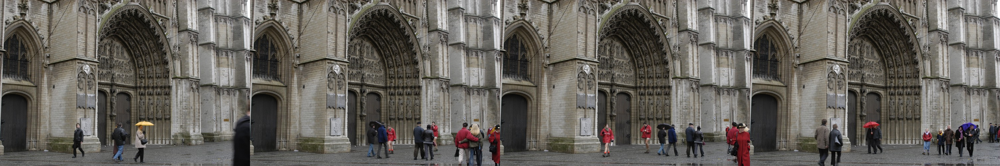

In [372]:
imshow(np.concatenate([*images], 1))

## liczenie odchylenia standardowego

Naszym pomysłem było liczenie odchylenia standardowego po pilselach na wszystkich obrazach. tam gdzie to odchylenie jest małe, to znaczy ze w tym miescu była na wszystkich obrazach ta sama rzeczy tzn katedra. w ten sposób dosyć łatwo można wyciągnąć piksele dotyczące katedry.

koniec konców problem ten sprowadza się do binarnej klasyfikacji, gdzie stramay sie okreslić cz dany piklsel na obrazie jest Katedrą czy szumem (człowiekiem)


In [555]:
#odchylenie standardowe dla rgb
def calculate_std(img):
    images = img.copy()
    width, height,_ = images[0].shape
    std_image = np.zeros((width, height))
    for x in range(width):
        for y in range(height):
            std_image[x,y] = np.std(images[:,x,y])
            
    return std_image
#odchylenie standardowe dla poszczególnego koloru
def calculate_std_color(img,color):
    images = img.copy()
    width, height,_ = images[0].shape
    std_image = np.zeros((width, height))
    std_image = np.std(images[:,:,:,color], axis=0)
            
    return std_image

### wizualizacje odchyleń

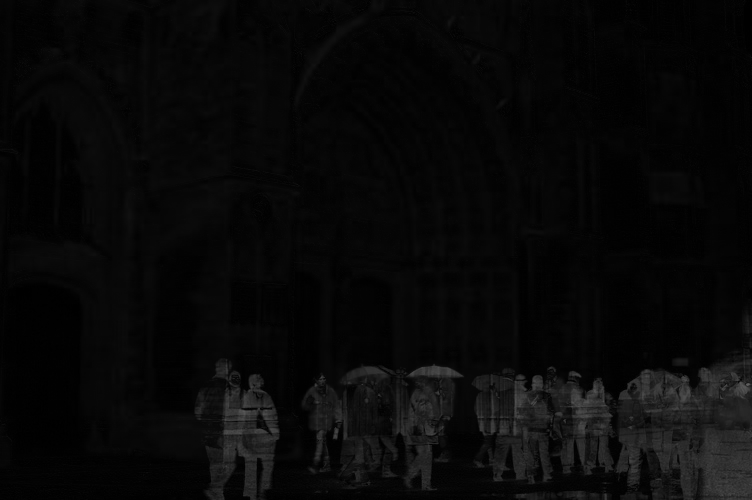

In [375]:
std_img = calculate_std(images)
imshow(std_img)

(500, 752)


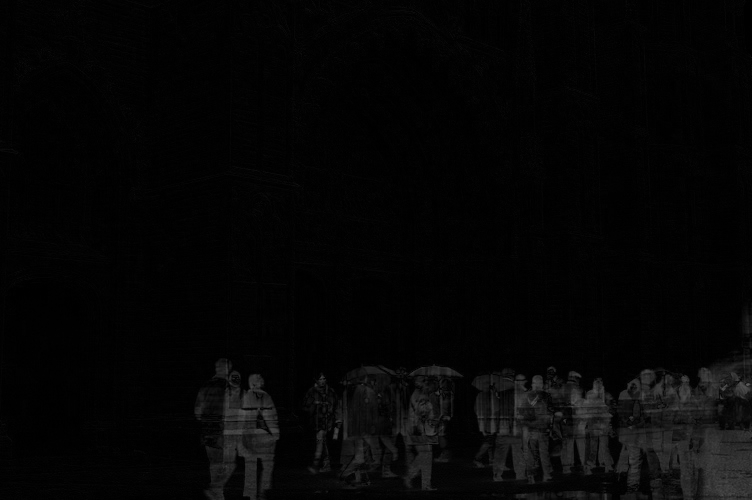

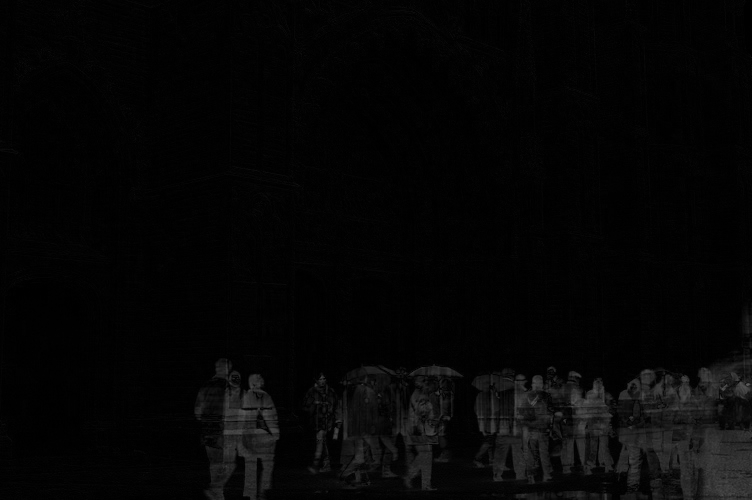

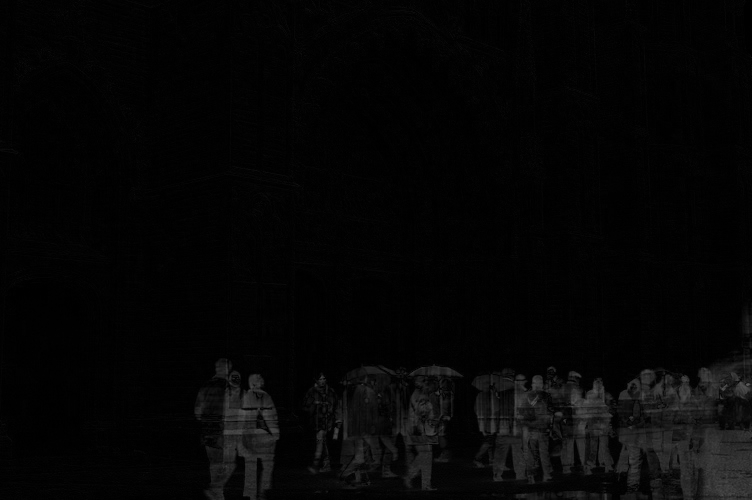

In [376]:
std_img_red = calculate_std_color(images,0)
print(std_img_red.shape)
imshow(std_img_red)
std_img_green = calculate_std_color(images,1)
imshow(std_img_red)
std_img_blue = calculate_std_color(images,2)
imshow(std_img_red)

### suma odchylen dla wszytskich 3 kolorów

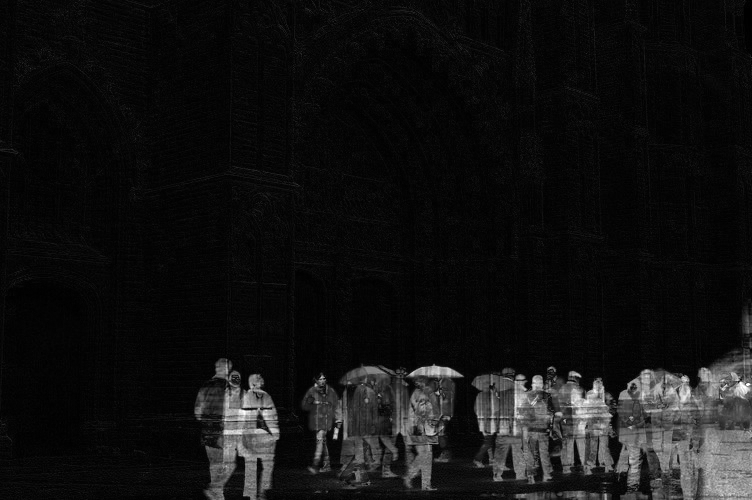

In [377]:
std_img = sum([std_img_red,std_img_green,std_img_blue])
imshow(std_img)

### znormalizujmy obraz, bo zawsze warto

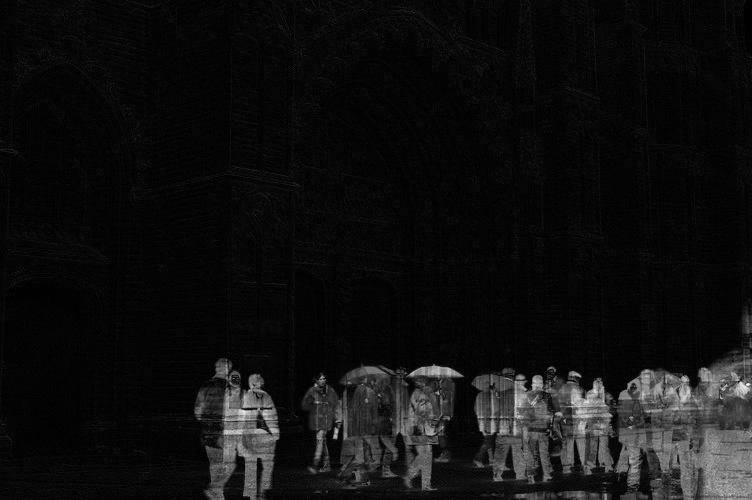

In [378]:
norm_std_img = np.zeros(std_img.shape)
norm_std_img = cv2.normalize(std_img, norm_std_img, 0, 255, cv2.NORM_MINMAX)
imshow(norm_std_img)

## Analiza histogramu w celu wyboru arbitralnego progu odcięcia 

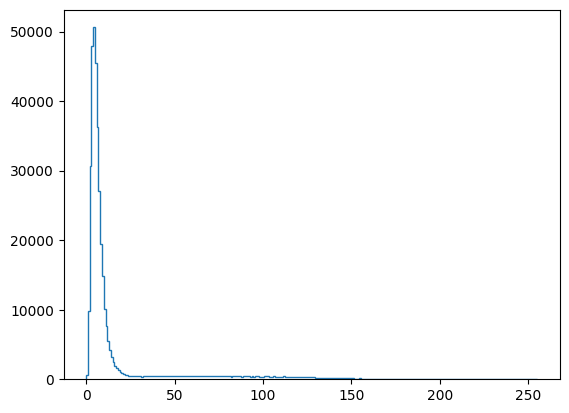

In [379]:
h, _, _ = plt.hist(norm_std_img.flatten(), 256, histtype='step')
plt.show() 

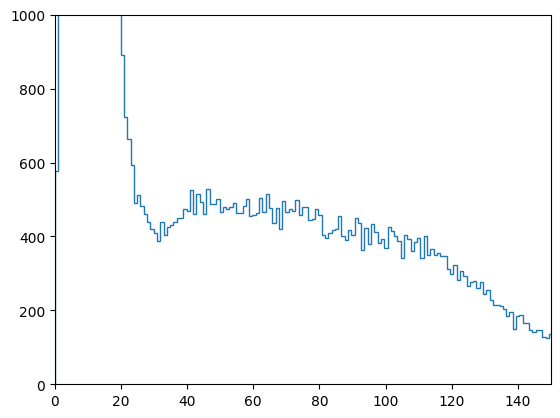

In [380]:
h, _, _ = plt.hist(norm_std_img.flatten(), 256, histtype='step')
plt.xlim(0, 150)
plt.ylim(0, 1000)
plt.show() 

### Jako próg odcięcia przyjęliśmy wartość 35 

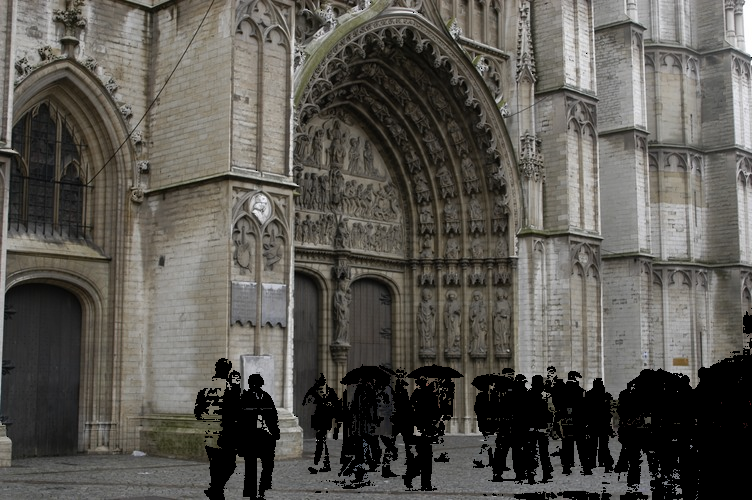

In [384]:
TP = median_img.copy() 
TP[norm_std_img>35] = 0
imshow(TP)

## Jak widać powyższy obrazek wnosi do naszego problemu sporo informacji, zawiera on wycietych wszystkich ludzi z naszych danych wejściowych. oznaczamy go jako TP (True Positive) bo zawiera piksele które są w 100% katedrą. 


## A teraz zróbmy coś czego nie zrobiliśmy na początku, zobaczmy jak wygląda średni oraz medianowy obraz

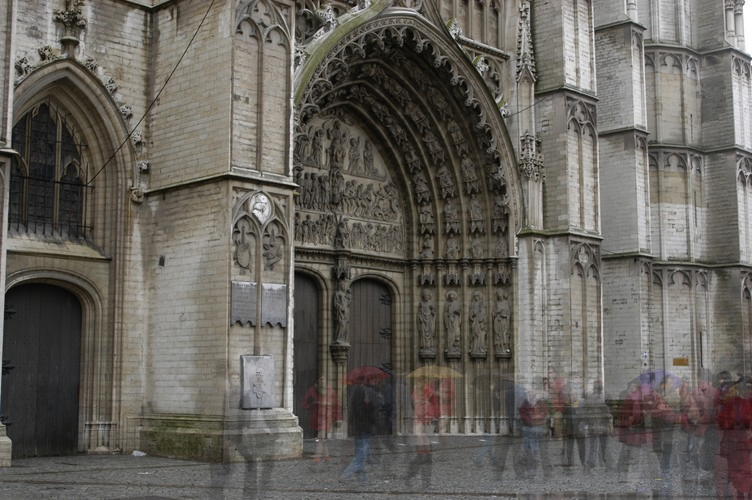

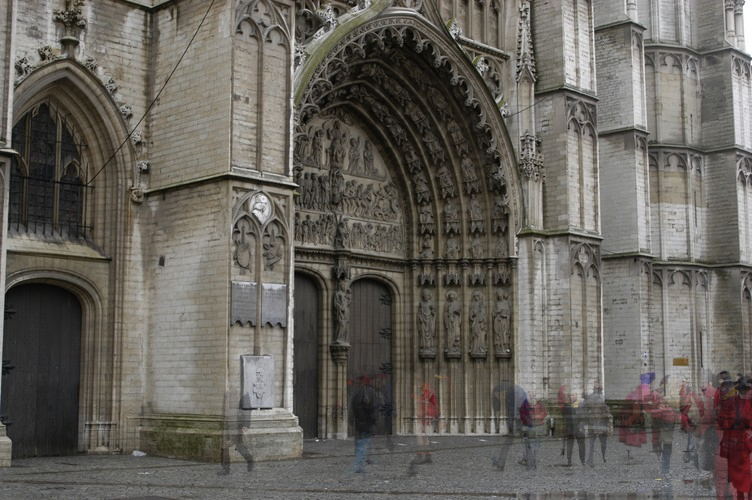

In [383]:
mean_img =np.mean(images, axis=0)
imshow(mean_img)
median_img =np.median(images, axis=0)
imshow(median_img)

### Nie jest źle, ludzie zamienili się w duchy, chociaż czerowona pani w pawym dolnym rogu troszkę psuje rezultat. 


## Dotychczas wykonaliśmy analizę odchylenia standardowego dla wszystkich obrazów. Zmieńmy podejście. Analizujmy obrazy parami. W teorii jeżeli na danych 2 obrazach, dany piskel jest podobny znaczy to, że w tym miejscu powinna być katedra


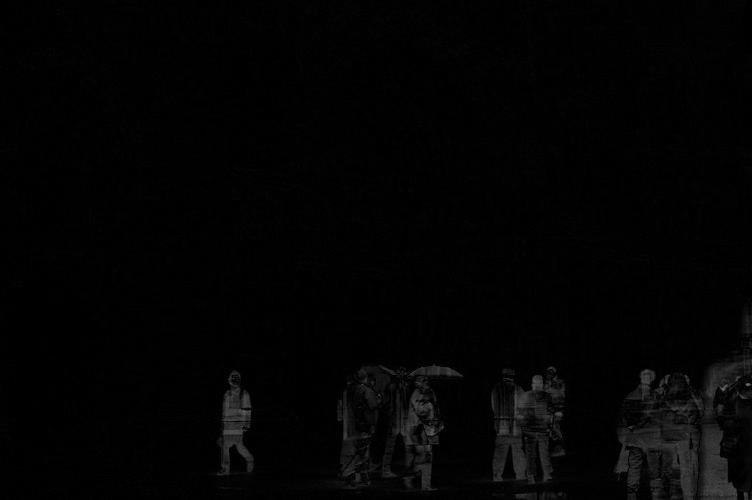

In [385]:
#wizualizacja dla przykładowej pary
imshow(calculate_std_color(np.asarray([images[0],images[1]]),0))

## Policzmy teraz taką samą analizę odchylenia dla dla wszytskich par obrazów

In [405]:
partail_images=[]
for i in range(len(images)):
    for j in range(len(images)):
        if i!=j:
            std_img_red = calculate_std_color(np.asarray([images[i],images[j]]),0)
            std_img_green = calculate_std_color(np.asarray([images[i],images[j]]),1)
            std_img_blue = calculate_std_color(np.asarray([images[i],images[j]]),2)
            std_img = sum([std_img_red,std_img_green,std_img_blue])
            norm_std_img = np.zeros(std_img.shape)
            norm_std_img = cv2.normalize(std_img, norm_std_img, 0, 255, cv2.NORM_MINMAX)
            mask_img = np.mean([images[i],images[j]], axis=0)
            mask_img[norm_std_img>12] = 0
            partail_images.append(mask_img)

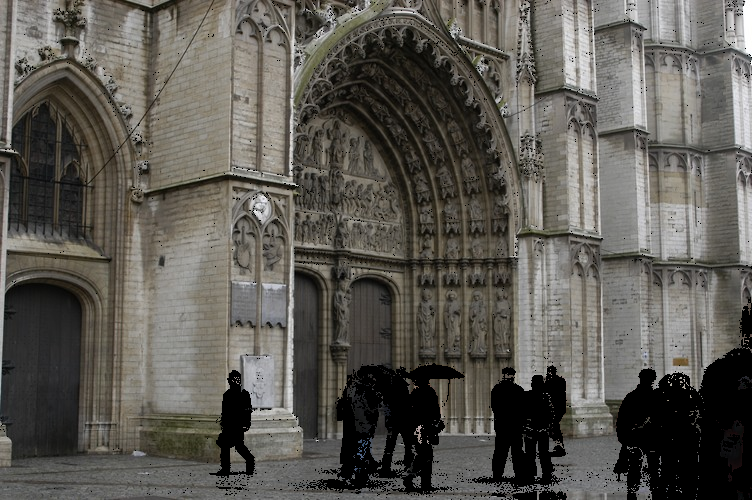

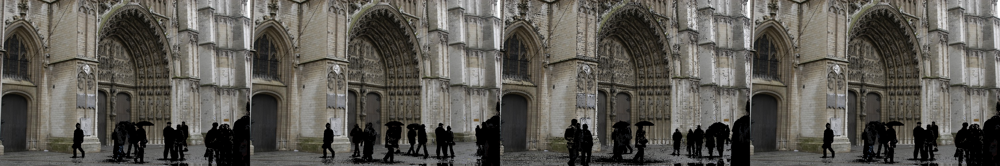

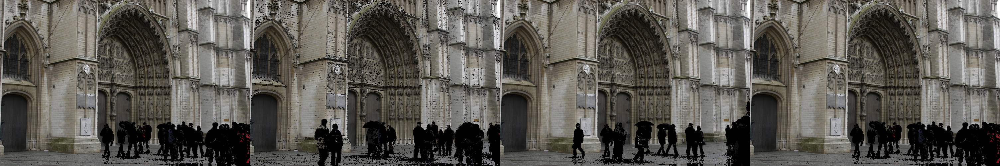

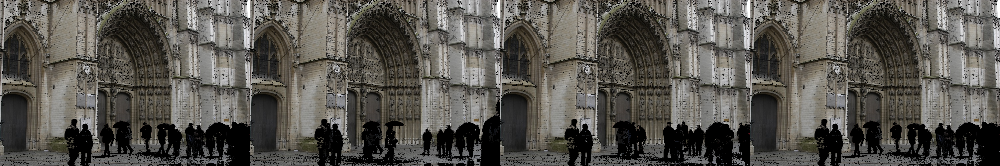

In [406]:
imshow(partail_images[0])
imshow(np.concatenate(partail_images[0:4], 1))
imshow(np.concatenate(partail_images[4:8], 1))
imshow(np.concatenate(partail_images[8:12], 1))
#imshow(np.concatenate(partail_images[12:16], 1))
#imshow(np.concatenate(partail_images[16:], 1))

## Konkatenacja tych obrazów w jeden

C:\Users\krmartin\AppData\Local\Temp\ipykernel_16736\2702922062.py:10: RuntimeWarning: invalid value encountered in divide
  final1 = sum_img/cnt
C:\Users\krmartin\AppData\Local\Temp\ipykernel_16736\4154653292.py:2: RuntimeWarning: invalid value encountered in cast
  a = a.clip(0, 255).astype('uint8')


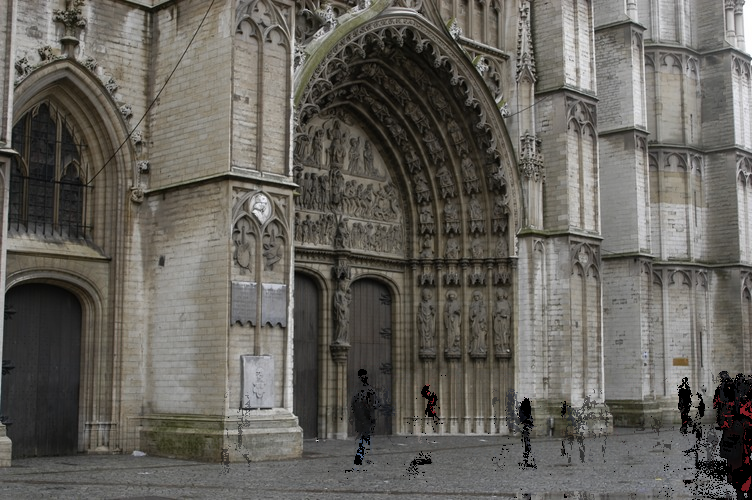

In [407]:
final_images = partail_images.copy()
final_images.append(mask_img)
final_images = np.asarray(final_images)
binary_final_images = final_images.copy()
binary_final_images[final_images>0] = 1

sum_img = np.sum(final_images, axis=0) 
cnt = np.sum(binary_final_images, axis=0) 

final1 = sum_img/cnt
imshow(final1)

## jak widać na powyzszym obrazie, zaiera on znacząco więcej pikseli samej katedy. Ma jednak zasadniczą wadę piksele FP. przez to ,że ta czerowna pani występuje na 2 obrazkach w tym samym miejscu, to podejście uznaje ze w sumie skoro taki piksel był taki sam na obu obrazach to jest to katedra

## Przejdzmy teraz do analizy samych kolorów na obrazach. Policzmy najpier jaki jest średni kolor katedry

(500, 752, 3)
[ 90.25427305  97.1815891  100.50125222]


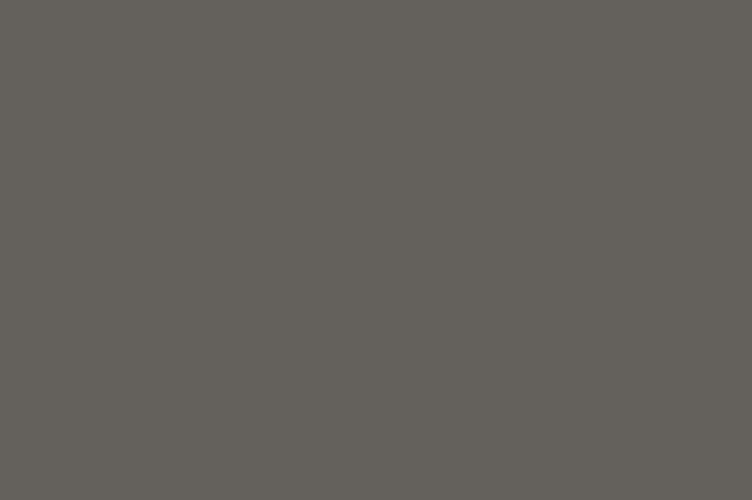

In [390]:
print(mask_img.shape)

mean_color = mask_img[:300,:].mean(axis=(0, 1)) #tylko górna część
print(mean_color)

mean_color_vizualization = np.zeros(mask_img.shape)
mean_color_vizualization[:,:,:] = mean_color
imshow(mean_color_vizualization)

## Dokłaadnie tego się spodziewalismy, katedra jest szara. Zastanówmy sie czym sa kolory szarości. kolory szarości leżą na przekątnej sześcianu rgb, tzn charekteryzują się podobnym nasyceniem wszytskich 3 kolorów. Zauważmy ze na obrazkach ludzie noszą kurtki o dość intensywnych kolorach. To znaczy takich w których dominuje jakiś barwinik np czerowny w płaszczu starszej pani. kolory takie caharteryzują się wysokim odchyleniem standardowych dla wartości rgb, policzmy zatem to

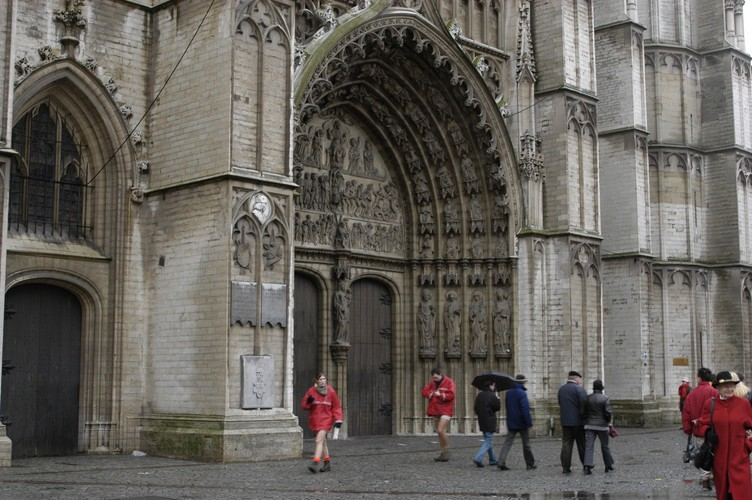

In [391]:
imshow(images[2])


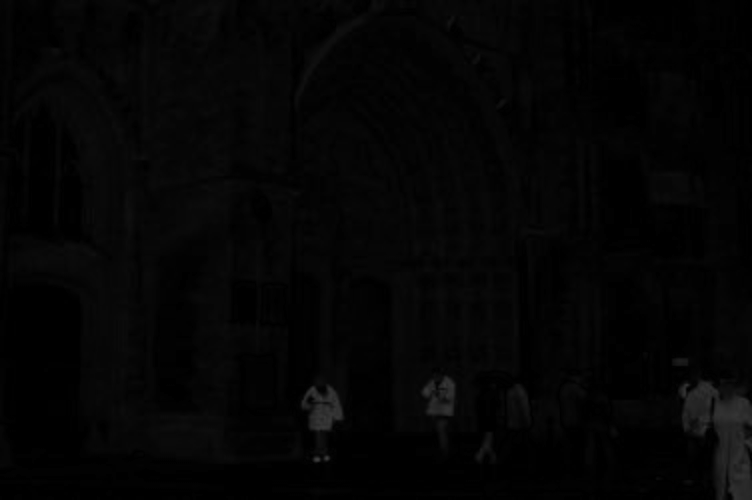

In [392]:
std_color = np.std(images[2], axis=2)
imshow(std_color)

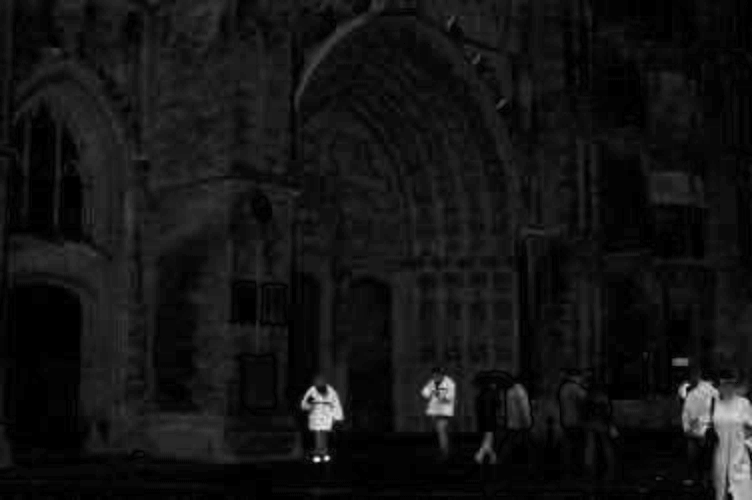

In [393]:
norm_std_color  = np.zeros(std_img.shape)
norm_std_color= cv2.normalize(std_color, norm_std_color, 0, 255, cv2.NORM_MINMAX)
imshow(norm_std_color)

## jak widać powyżej udało się ładnie na pojedyńczym obrazie wykryć intensywne kolory ubrań ludzi. usuń my ich zatem z obrazu

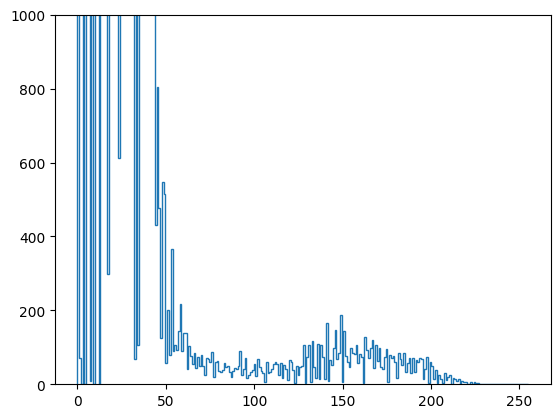

In [394]:
h, _, _ = plt.hist(norm_std_color.flatten(), 256, histtype='step')
#plt.xlim(0, 256)
plt.ylim(0, 1000)
plt.show() 

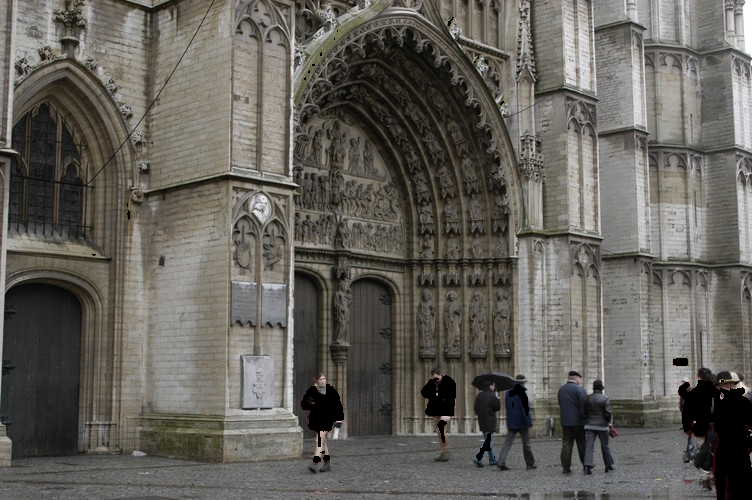

In [395]:
mask_color_std_img = images[2].copy() 
mask_color_std_img[norm_std_color>60] = 0
imshow(mask_color_std_img)

## Teraz spóbuj my tego samego ale z analizą saturacji dla przestrzeni hsv

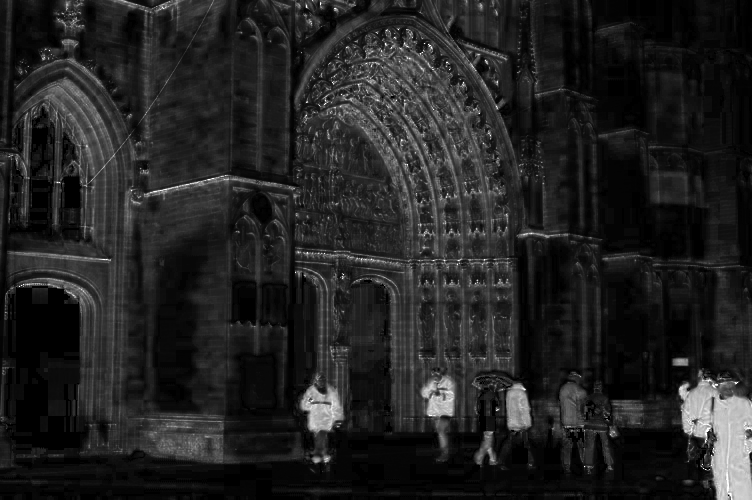

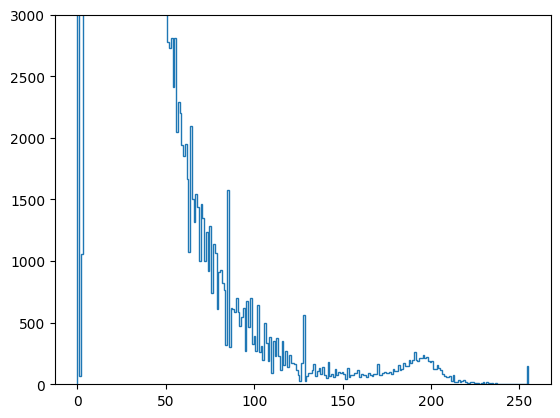

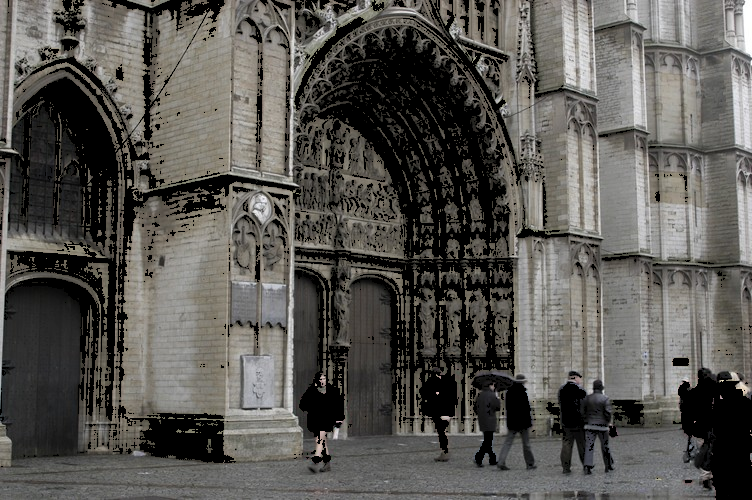

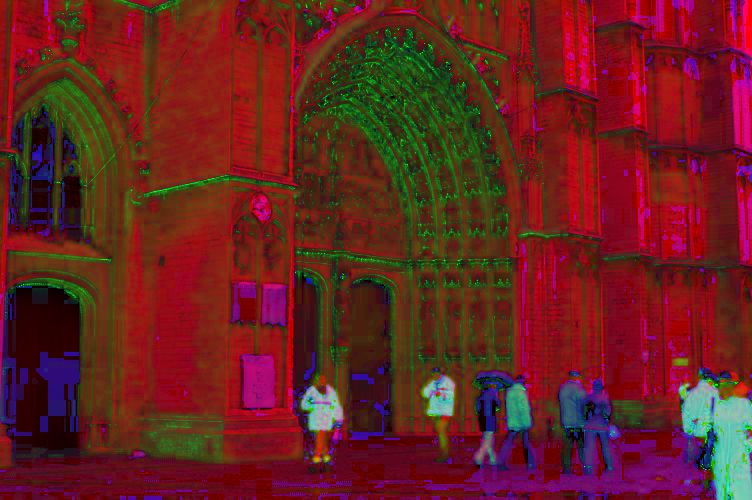

In [545]:
hsv_img = cv2.cvtColor(images[2], cv2.COLOR_BGR2HSV)
norm_hsv  = np.zeros(std_img.shape)
norm_hsv= cv2.normalize(hsv_img[:,:,1],norm_hsv, 0, 255, cv2.NORM_MINMAX)
imshow(norm_hsv)
h, _, _ = plt.hist(norm_hsv.flatten(), 256, histtype='step')
#plt.xlim(0, 256)
plt.ylim(0, 3000)
plt.show() 
mask_color_hsv = images[2].copy() 
mask_color_hsv[norm_hsv>50] = 0
imshow(mask_color_hsv)
imshow(hsv_img)



## Tutaj sprawdzenie czy może jakiś lokalny treshold coś polepszy zamiast globalnego, ale eksprymenty zaniechane. 

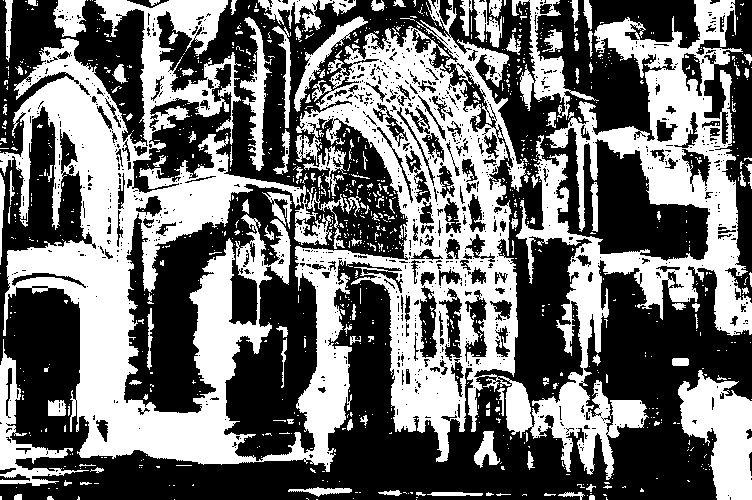

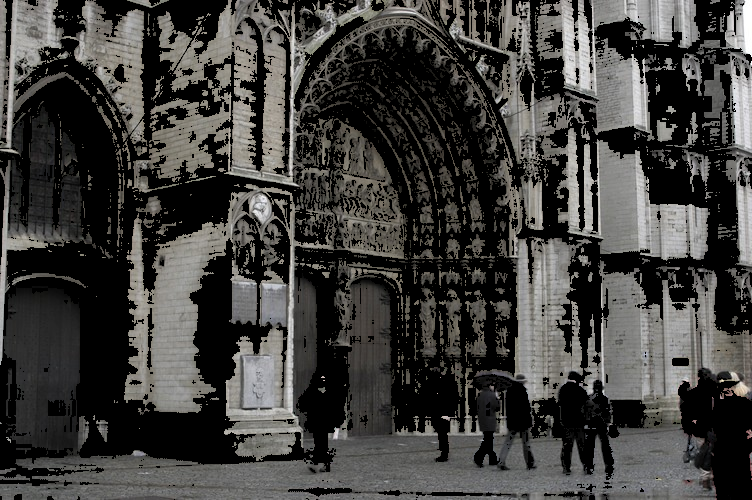

In [397]:
window_size =151
thresh_sauvola = threshold_sauvola(norm_hsv, window_size=window_size,  k=0.1)
binary_sauvola = norm_hsv > thresh_sauvola
imshow(binary_sauvola*255)

mask_color_hsv = images[2].copy() 
mask_color_hsv[binary_sauvola] = 0
imshow(mask_color_hsv)


## usuńmy więc zbędne kolory z obrazów

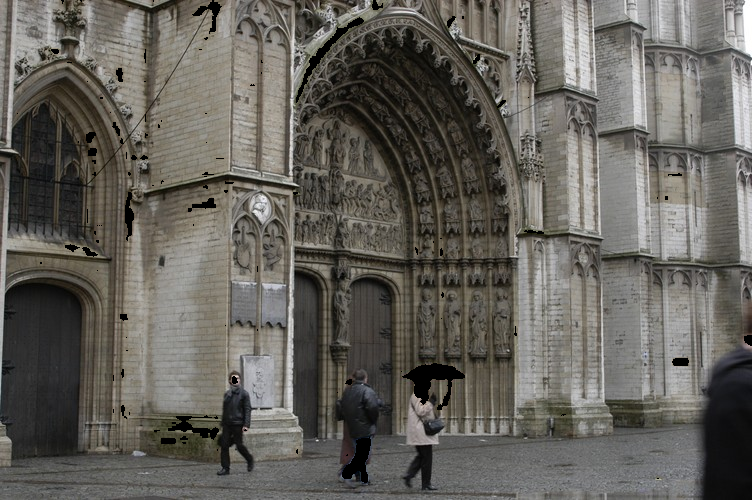

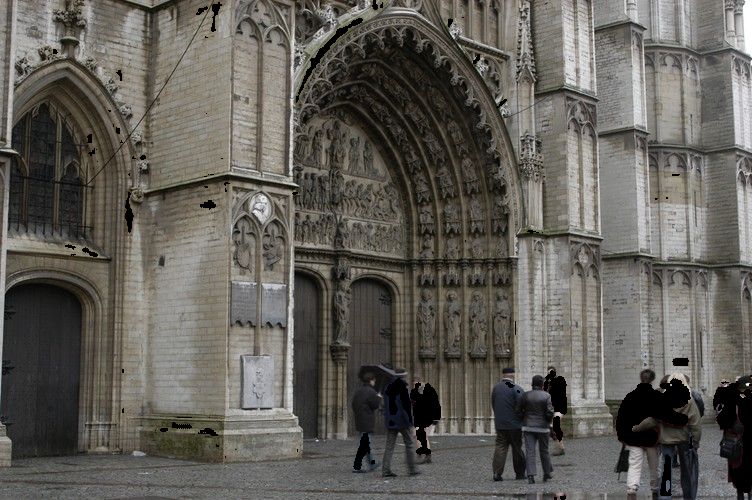

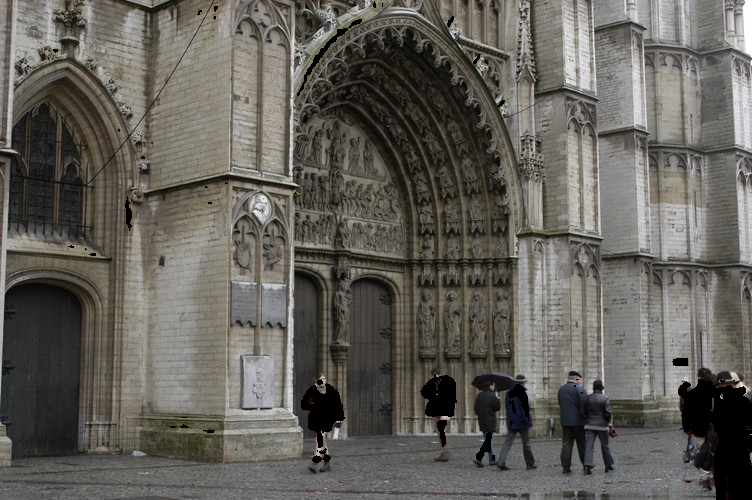

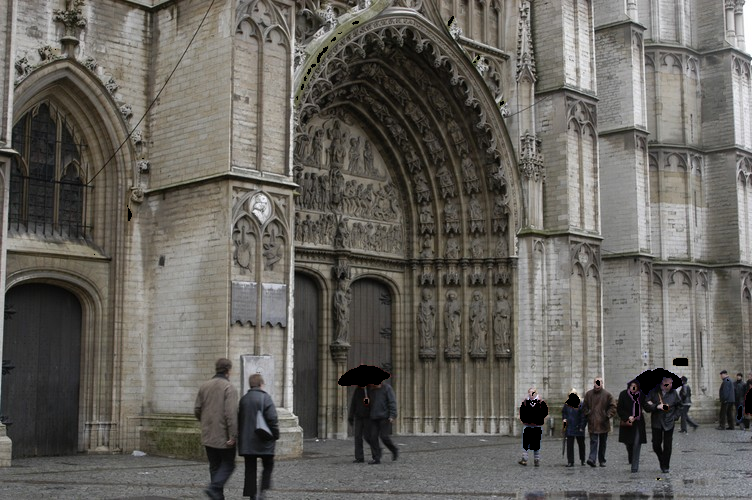

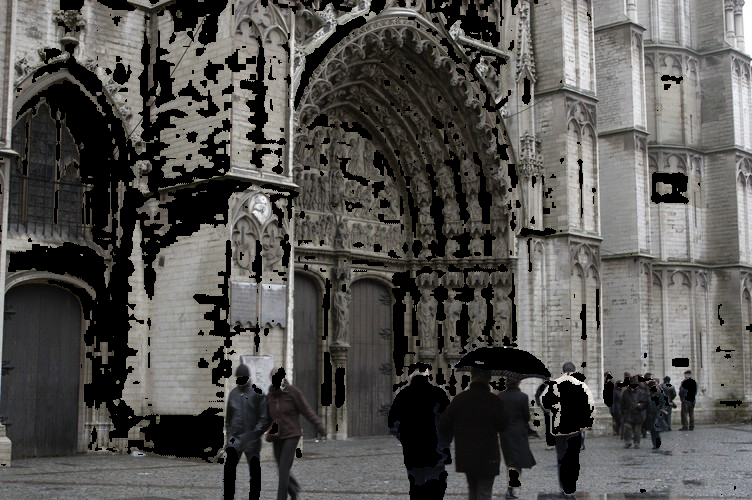

In [547]:
threshold_images =[]
for image in images5:
    hsv_img = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    hsv_img = np.std(image, axis=2)
    norm_hsv  = np.zeros(std_img.shape)
    #norm_hsv= cv2.normalize(hsv_img[:,:,1],norm_hsv, 0, 255, cv2.NORM_MINMAX)
    norm_hsv= cv2.normalize(hsv_img,norm_hsv, 0, 255, cv2.NORM_MINMAX)
    mask_color_hsv = image.copy() 
    mask_color_hsv[norm_hsv>50] = 0
    imshow(mask_color_hsv)
    threshold_images.append(mask_color_hsv)

threshold_images = np.asarray(threshold_images)
#     window_size =351
#     thresh_sauvola = threshold_sauvola(norm_hsv, window_size=window_size,  k=0.1)
#     binary_sauvola = norm_hsv > thresh_sauvola

#     mask_color_hsv2 = image.copy() 
#     mask_color_hsv2[binary_sauvola] = 0
#     imshow(mask_color_hsv2)

## Wyświetlmy teraz średni obraz przed i po dokonaniu takiej transformacji

C:\Users\krmartin\AppData\Local\Temp\ipykernel_16736\417781838.py:6: RuntimeWarning: invalid value encountered in divide
  mean_after_removing_red_grandmam = sum_img2/cnt2


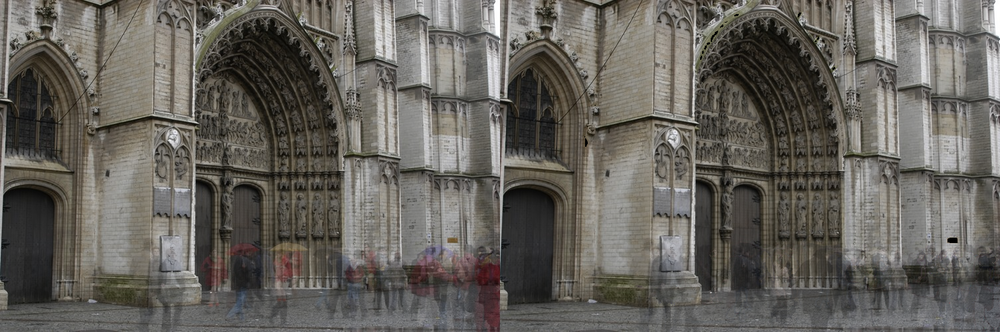

In [559]:
binary_final_images2 = threshold_images.copy()
binary_final_images2[threshold_images>0] = 1
sum_img2 = np.sum(threshold_images, axis=0) 
cnt2=np.sum(binary_final_images2, axis=0) 

mean_after_removing_red_grandmam = sum_img2/cnt2

mean_after_removing_red_grandmam[np.isnan(mean_after_removing_red_grandmam)] =0 
imshow(np.concatenate([mean_img,mean_after_removing_red_grandmam],1))

### Jak widać mamy znaczącą poprawę. Nawet na dostatecznie słabym rzutniku w sali, oglądajacy obrazek nie zauwazyli by na nim ludzi

## Zaaplikujemy teraz analizę odchyleń standardowych na parach obrazów, ale już wstępnie przeprocessowanych

C:\Users\krmartin\AppData\Local\Temp\ipykernel_16736\789336839.py:24: RuntimeWarning: invalid value encountered in divide
  final2_4 = sum_img/cnt
C:\Users\krmartin\AppData\Local\Temp\ipykernel_16736\789336839.py:49: RuntimeWarning: invalid value encountered in divide
  final2 = sum_img/cnt
C:\Users\krmartin\AppData\Local\Temp\ipykernel_16736\4154653292.py:2: RuntimeWarning: invalid value encountered in cast
  a = a.clip(0, 255).astype('uint8')


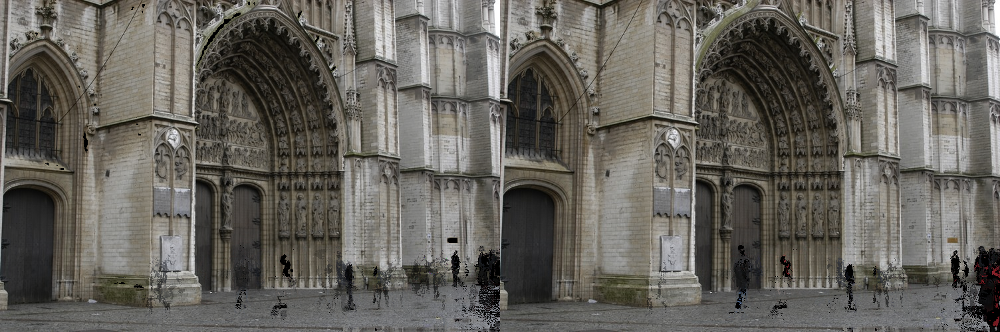

In [564]:
partail_images=[]
for i in range(len(threshold_images[:4])):
    for j in range(len(threshold_images[:4])):
        if i!=j:
            std_img_red = calculate_std_color(np.asarray([threshold_images[i],threshold_images[j]]),0)
            std_img_green = calculate_std_color(np.asarray([threshold_images[i],threshold_images[j]]),1)
            std_img_blue = calculate_std_color(np.asarray([threshold_images[i],threshold_images[j]]),2)
            std_img = sum([std_img_red,std_img_green,std_img_blue])
            norm_std_img = np.zeros(std_img.shape)
            norm_std_img = cv2.normalize(std_img, norm_std_img, 0, 255, cv2.NORM_MINMAX)
            mask_img = np.mean([threshold_images[i],threshold_images[j]], axis=0)
            mask_img[norm_std_img>12] = 0
            partail_images.append(mask_img)

final_images = partail_images.copy()
final_images.append(mask_img)
final_images = np.asarray(final_images)
binary_final_images = final_images.copy()
binary_final_images[final_images>0] = 1

sum_img = np.sum(final_images, axis=0) 
cnt = np.sum(binary_final_images, axis=0) 

final2_4 = sum_img/cnt

partail_images=[]
for i in range(len(threshold_images)):
    for j in range(len(threshold_images)):
        if i!=j:
            std_img_red = calculate_std_color(np.asarray([threshold_images[i],threshold_images[j]]),0)
            std_img_green = calculate_std_color(np.asarray([threshold_images[i],threshold_images[j]]),1)
            std_img_blue = calculate_std_color(np.asarray([threshold_images[i],threshold_images[j]]),2)
            std_img = sum([std_img_red,std_img_green,std_img_blue])
            norm_std_img = np.zeros(std_img.shape)
            norm_std_img = cv2.normalize(std_img, norm_std_img, 0, 255, cv2.NORM_MINMAX)
            mask_img = np.mean([threshold_images[i],threshold_images[j]], axis=0)
            mask_img[norm_std_img>12] = 0
            partail_images.append(mask_img)

final_images = partail_images.copy()
final_images.append(mask_img)
final_images = np.asarray(final_images)
binary_final_images = final_images.copy()
binary_final_images[final_images>0] = 1

sum_img = np.sum(final_images, axis=0) 
cnt = np.sum(binary_final_images, axis=0) 

final2 = sum_img/cnt


imshow(np.concatenate([final2,final1],1))


## jak widać, udało się nam zmiejszyć liczbę FP pikseli

## pora dostawić do obrazu piksele wcześniej oznaczone jako TP

C:\Users\krmartin\AppData\Local\Temp\ipykernel_16736\4154653292.py:2: RuntimeWarning: invalid value encountered in cast
  a = a.clip(0, 255).astype('uint8')


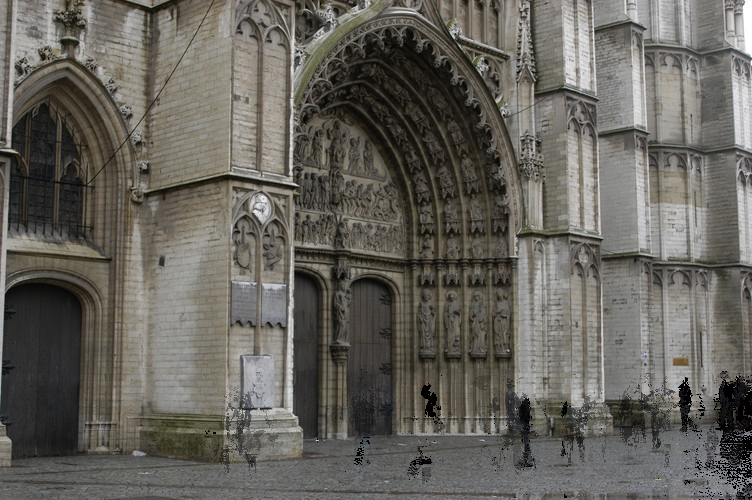

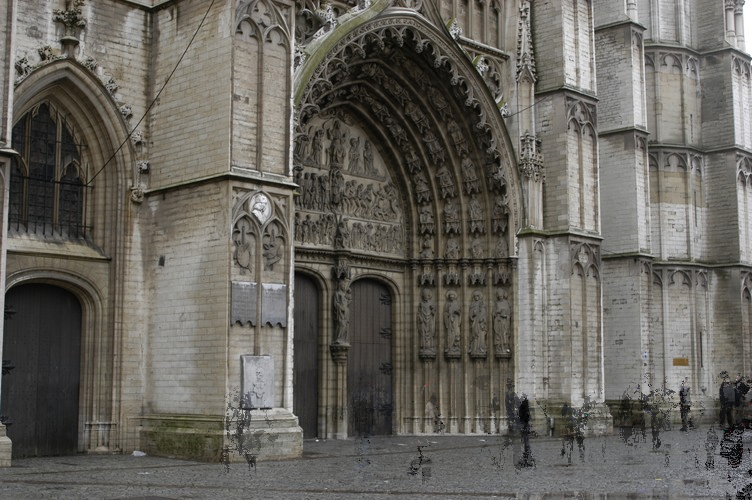

In [553]:

final2[TP>0] = TP[TP>0]
imshow(final2)

#final2[np.isnan(final2) ] = 0
final2[ np.isnan(final2) ] = mean_after_removing_red_grandmam[np.isnan(final2)]
final2[np.isnan(final2) ] = 0
imshow(final2)
#final2 = cv2.medianBlur(final2.astype('uint8'), 3)
#imshow(final2)

## Na koniec aplikujemy metody pozwlające na usunięcie, wypełnienie jakoś powstałego szumu na obrazku


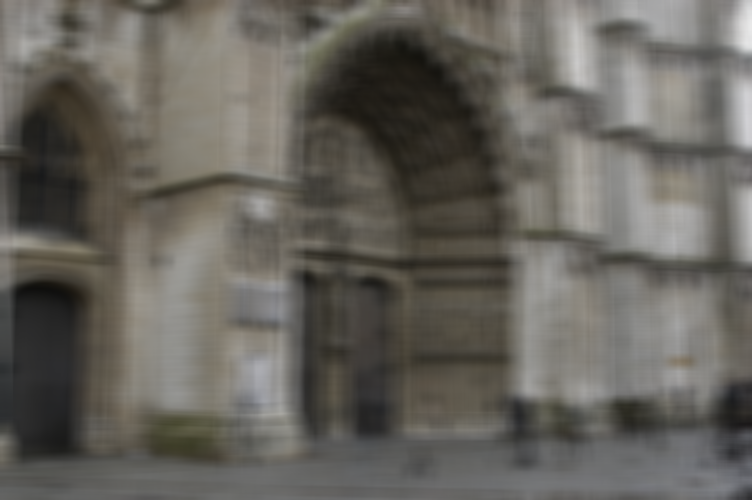

[  0.           1.           1.66666667 ... 254.6        254.8
 255.        ] [1063    2    1 ...  101  174  322]


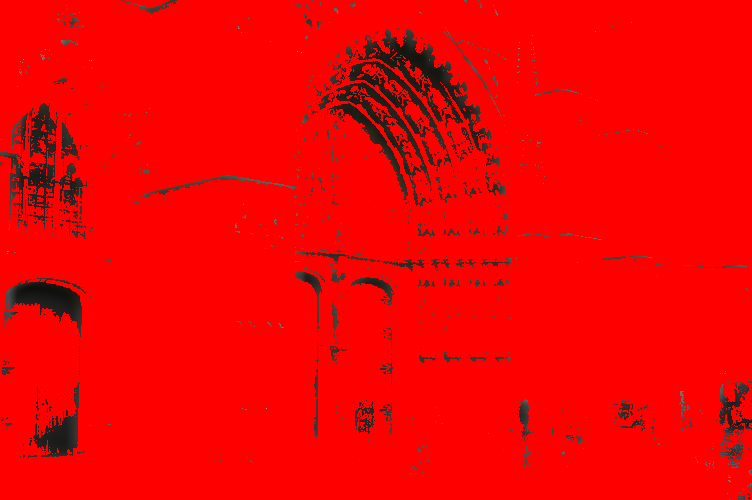

In [554]:
#final_final = cv2.medianBlur(final2.astype('uint8'), 25)
final_final = cv2.blur(final2.astype('uint8'), (25,11))
imshow(final_final)

hsv_final_img = cv2.cvtColor(final2.astype('uint8'), cv2.COLOR_BGR2HSV)
black_pixels = np.all(final2 == [0,0,0], axis =-1)
final_final[~(hsv_final_img[:,:,2] <35)] = np.array([0,0,255])#final2[~(hsv_final_img[:,:,2] <35)]

unique, counts = np.unique(mean_after_removing_red_grandmam, return_counts=True)
print(unique, counts)
imshow(final_final)

[[139.2 143.8 153.4]
 [142.4 147.  156.6]
 [146.  150.  159.8]
 ...
 [ 96.2  99.   98.6]
 [101.8 104.6 104.2]
 [ 96.6  99.4  99. ]]


array([[139.2, 143.8, 153.4],
       [142.4, 147. , 156.6],
       [146. , 150. , 159.8],
       ...,
       [ 96.2,  99. ,  98.6],
       [101.8, 104.6, 104.2],
       [ 96.6,  99.4,  99. ]])

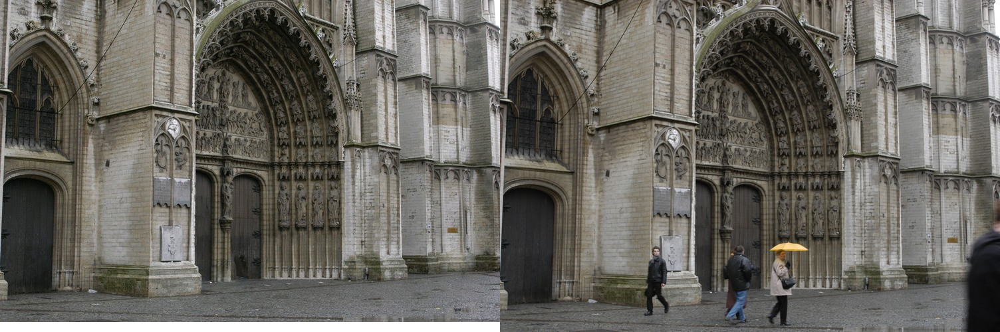

In [ ]:
imshow(np.concatenate([result, images[0]], 1))